In [1]:
import pandas as pd
df = pd.read_csv('data/Reviews.csv')
df.head()

,Id,ProductId,UserId,ProfileName,HelpfulnessNumerator,HelpfulnessDenominator,Score,Time,Summary,Text
0,1,B001E4KFG0,A3SGXH7AUHU8GW,delmartian,1,1,5,1303862400,Good Quality Dog Food,I have bought several of the Vitality canned d...
1,2,B00813GRG4,A1D87F6ZCVE5NK,dll pa,0,0,1,1346976000,Not as Advertised,Product arrived labeled as Jumbo Salted Peanut...
2,3,B000LQOCH0,ABXLMWJIXXAIN,"Natalia Corres ""Natalia Corres""",1,1,4,1219017600,"""Delight"" says it all",This is a confection that has been around a fe...
3,4,B000UA0QIQ,A395BORC6FGVXV,Karl,3,3,2,1307923200,Cough Medicine,If you are looking for the secret ingredient i...
4,5,B006K2ZZ7K,A1UQRSCLF8GW1T,"Michael D. Bigham ""M. Wassir""",0,0,5,1350777600,Great taffy,Great taffy at a great price. There was a wid...


In [2]:
# Will mostly look at Text, Summary, and Score

# now will take a look at Score to see if positive or negative for the majority of the customer ratings

import matplotlib.pyplot as plt
import seaborn as sns
color = sns.color_palette()
%matplotlib inline
import plotly.offline as py
py.init_notebook_mode(connected = True)
import plotly.graph_objs as go
import plotly.tools as tls
import plotly.express as px

# ploting scores

fig = px.histogram(df, x="Score")
fig.update_traces(marker_color="turquoise",marker_line_color='rgb(8,48,107)', marker_line_width=1.5)
fig.update_layout(title_text='Product Score')
fig.show()

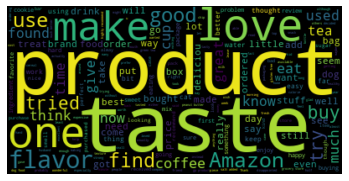

In [3]:
# Since most of the customer rating is positive, it could be that most reviews will be pretty positive too

# Now, create some "wordclouds" to see the most frequently used words in reviews
import wordcloud
from wordcloud import WordCloud, STOPWORDS
import nltk # libary used for natural language processing
from nltk.corpus import stopwords

#Create stopword list:
stopwords = set(STOPWORDS)
stopwords.update(["br", "href"])
textt = " ".join(review for review in df.Text)
wordcloud = WordCloud(stopwords = stopwords).generate(textt)

plt.imshow(wordcloud, interpolation='bilinear')
plt.axis("off")
plt.savefig('wordcloud11.png')
plt.show()



In [4]:
# classify reviews into "positive" +1 or "negative" -1
# all Score > 3 is +1, Score < 3 is -1, Score = 3 is neutral so dropped

df = df[df['Score'] != 3]
df['sentiment'] = df['Score'].apply(lambda rating: +1 if rating >3 else -1)
df.head()

,Id,ProductId,UserId,ProfileName,HelpfulnessNumerator,HelpfulnessDenominator,Score,Time,Summary,Text,sentiment
0,1,B001E4KFG0,A3SGXH7AUHU8GW,delmartian,1,1,5,1303862400,Good Quality Dog Food,I have bought several of the Vitality canned d...,1
1,2,B00813GRG4,A1D87F6ZCVE5NK,dll pa,0,0,1,1346976000,Not as Advertised,Product arrived labeled as Jumbo Salted Peanut...,-1
2,3,B000LQOCH0,ABXLMWJIXXAIN,"Natalia Corres ""Natalia Corres""",1,1,4,1219017600,"""Delight"" says it all",This is a confection that has been around a fe...,1
3,4,B000UA0QIQ,A395BORC6FGVXV,Karl,3,3,2,1307923200,Cough Medicine,If you are looking for the secret ingredient i...,-1
4,5,B006K2ZZ7K,A1UQRSCLF8GW1T,"Michael D. Bigham ""M. Wassir""",0,0,5,1350777600,Great taffy,Great taffy at a great price. There was a wid...,1


In [5]:
# build WordClouds for pos and neg

positive = df[df['sentiment'] == 1]
negative = df[df['sentiment'] == -1]

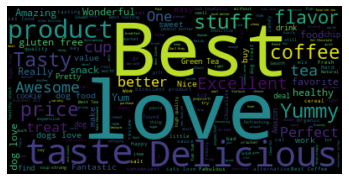

In [6]:
# Wordcloud - Positive Sentiment
stopwords = set(STOPWORDS)
stopwords.update(["br", "href", "good", "great"])
# good and greate removed because they were included in negative sentiment

pos = " ".join(review for review in positive.Summary)
wordcloud2 = WordCloud(stopwords=stopwords).generate(pos)

plt.imshow(wordcloud2, interpolation='bilinear')
plt.axis("off")
plt.show()

/Users/suqingliu/opt/anaconda3/lib/python3.9/site-packages/pandas/core/frame.py:3641: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



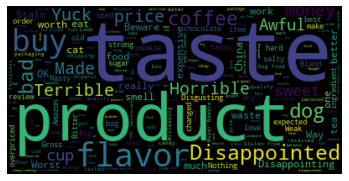

In [9]:
#Wordcloud - Negative Sentiment

negative[['Summary']] = df[['Summary']].fillna(' ')

neg = " ".join(review for review in negative.Summary)
wordcloud3 = WordCloud(stopwords=stopwords).generate(neg)

plt.imshow(wordcloud3, interpolation='bilinear')
plt.axis("off")
plt.savefig('wordcloud33.png')
plt.show()

In [10]:
df['sentiment'] = df['sentiment'].replace({-1: 'negative'})
df['sentiment'] = df['sentiment'].replace({1: 'positive'})
fig = px.histogram(df, x="sentiment")
fig.update_traces(marker_color="indianred",marker_line_color='rgb(8,48,107)',marker_line_width=1.5)
fig.update_layout(title_text='Product Sentiment')
fig.show()

In [11]:
# Building the Model
# This model takes reviews in as input, and determine if the review is positive or negative
# this is classification, so we will train a simple logistic regression model for this


# Data Cleaning: remove all punctuations
def remove_punctuation(text):
    final = "".join(u for u in text if u not in ("?", ".", ";", ":", "!", '"'))
    return final

df['Text'] = df['Text'].apply(remove_punctuation)
df = df.dropna(subset=['Summary'])
df['Summary'] = df['Summary'].apply(remove_punctuation)

In [12]:
# Split the Dataframe

# The new data frame should only have two columns - "Summary"(review text data), and "sentiment" (target variable)

dfNew = df[['Summary', 'sentiment']]
dfNew.head()


,Summary,sentiment
0,Good Quality Dog Food,positive
1,Not as Advertised,negative
2,Delight says it all,positive
3,Cough Medicine,negative
4,Great taffy,positive


In [17]:
# Split the data frame into train and test sets. 80% of for training, 20% for testing

import numpy as np

index = df.index
df['random_number'] = np.random.randn(len(index))

train = df[df['random_number'] <= 0.8]
test = df[df['random_number'] > 0.8]

In [22]:
# We will need to convert the text into a bag of words model since the logistic repression alogrithm cannot understand text
# use count vectorizer to transform text to bag of words

from sklearn.feature_extraction.text import CountVectorizer

vectorizer = CountVectorizer(token_pattern=r'\b\w+\b')
train_matrix = vectorizer.fit_transform(train['Summary'])
test_matrix = vectorizer.transform(test['Summary'])

In [29]:
# import logistic regression

from sklearn.linear_model import LogisticRegression
lr = LogisticRegression(max_iter = 400)

In [30]:
# split target and independent variables

X_train = train_matrix
X_test = test_matrix
y_train = train['sentiment']
y_test = test['sentiment']

In [31]:
#fit model on data
lr.fit(X_train, y_train)

LogisticRegression(max_iter=400)

In [32]:
# Make predictions
predictions = lr.predict(X_test)

In [34]:
#Testing
# find accuracy, precision, recall:

from sklearn.metrics import confusion_matrix, classification_report
new = np.asarray(y_test)
confusion_matrix(predictions, y_test)

array([[11457,  2310],
       [ 5784, 91877]])

In [36]:
print(classification_report(predictions,y_test))

              precision    recall  f1-score   support

    negative       0.66      0.83      0.74     13767
    positive       0.98      0.94      0.96     97661

    accuracy                           0.93    111428
   macro avg       0.82      0.89      0.85    111428
weighted avg       0.94      0.93      0.93    111428



In [37]:
# Overall Accuracy is 93%